In [2]:
import torch
import os

import sys
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))

file_id=6448

base_path="/home/eloi/projects/project_mfm_eloi/audio_examples/TM_val/"
file_dry=os.path.join(base_path, "dry",str(file_id),"vocals.wav")
file_wet=os.path.join(base_path, "wet",str(file_id),"vocals.wav")

file_dry_fxnorm=os.path.join(base_path,"dry", str(file_id), "vocals_normalized.wav")
file_wet_fxnorm=os.path.join(base_path, "wet",str(file_id), "vocals_normalized.wav")

file_dry_fxnorm_dr=os.path.join(base_path, "dry", str(file_id), "vocals_normalized_dr.wav")
file_wet_fxnorm_dr=os.path.join(base_path, "wet",str(file_id),"vocals_normalized_dr.wav")


In [3]:

import soundfile as sf

dry, sr = sf.read(file_dry)
wet, sr = sf.read(file_wet)


dry_fxnorm, sr = sf.read(file_dry_fxnorm)
wet_fxnorm, sr = sf.read(file_wet_fxnorm)



print("Dry file loaded with shape:", dry.shape)

start_t=15*sr
segment_length = 524288

dry_segment = dry[start_t:start_t + segment_length]
wet_segment = wet[start_t:start_t + segment_length]

dry_fxnorm_segment = dry_fxnorm[start_t:start_t + segment_length]
wet_fxnorm_segment = wet_fxnorm[start_t:start_t + segment_length]


x=torch.tensor(dry_segment.T, dtype=torch.float32).unsqueeze(0)
#stereo to mono 
x=x.mean(dim=1, keepdim=True)
print("Dry segment shape:", x.shape)

y=torch.tensor(wet_segment.T, dtype=torch.float32).unsqueeze(0)
print("Wet segment shape:", y.shape)

x_fxnorm=torch.tensor(dry_fxnorm_segment.T, dtype=torch.float32).unsqueeze(0)
x_fxnorm=x_fxnorm.mean(dim=1, keepdim=True)
y_fxnorm=torch.tensor(wet_fxnorm_segment.T, dtype=torch.float32).unsqueeze(0)
y_fxnorm=y_fxnorm.mean(dim=1, keepdim=True)



#play audio segment

import IPython.display as ipd

ipd.display(ipd.Audio(dry_segment.T, rate=sr, normalize=False))
ipd.display(ipd.Audio(wet_segment.T, rate=sr, normalize=False))

ipd.display(ipd.Audio(dry_fxnorm_segment.T, rate=sr, normalize=False))
ipd.display(ipd.Audio(wet_fxnorm_segment.T, rate=sr,normalize=False))



Dry file loaded with shape: (11065479, 2)
Dry segment shape: torch.Size([1, 1, 524288])
Wet segment shape: torch.Size([1, 2, 524288])


In [8]:
x_fxnorm.shape

torch.Size([1, 1, 524288])

In [18]:
from fx_model.diffvox.modules.fx import CompressorExpander

compressor = CompressorExpander(
        sr=44100,
        cmp_ratio = 2.0,
        exp_ratio = 0.5,
        at_ms = 50.0,
        rt_ms = 50.0,
        avg_coef = 0.3,
        cmp_th = -18.0,
        exp_th = -48.0,
        make_up = 0.0,
        delay = 0,
        lookahead = False,
        max_lookahead = 15.0,
)

#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device="cpu"
x_fxnorm = x_fxnorm.to(device).repeat(8, 1, 1)  # Repeat to simulate batch size of 8
y_fxnorm = y_fxnorm.to(device).repeat(8,1,1)
compressor = compressor.to(device)

print(x_fxnorm.device, y_fxnorm.device)
import time
for i in range(100):
        start=time.time()
        compressor=CompressorExpander(44100)
        with torch.no_grad():
                x_fxnorm_comp = compressor(x_fxnorm)
                #y_fxnorm_comp = compressor(y_fxnorm)
        print("Compressor processing time:", time.time() - start)

ipd.display(ipd.Audio(x_fxnorm_comp[0].detach().cpu(), rate=sr, normalize=False))
ipd.display(ipd.Audio(y_fxnorm_comp[0].detach().cpu(), rate=sr,normalize=False))



cpu cpu
Compressor processing time: 3.362400531768799
Compressor processing time: 3.4100229740142822
Compressor processing time: 3.3759026527404785
Compressor processing time: 3.25732421875
Compressor processing time: 3.463772773742676


KeyboardInterrupt: 

In [16]:
params_dict=compressor.state_dict()

for k,v in params_dict.items():
    print(f"{k}: {v} - {v.dtype} - {v.device}")

params.cmp_th: -18.0 - torch.float32 - cpu
params.exp_th: -48.0 - torch.float32 - cpu
params.make_up: 0.0 - torch.float32 - cpu
params.parametrizations.at.original: -6.909515857696533 - torch.float32 - cpu
params.parametrizations.rt.original: -6.909515857696533 - torch.float32 - cpu
params.parametrizations.avg_coef.original: -0.8472977876663208 - torch.float32 - cpu
params.parametrizations.cmp_ratio.original: -2.890371799468994 - torch.float32 - cpu
params.parametrizations.exp_ratio.original: 0.0 - torch.float32 - cpu


In [10]:
#get RMS  of x_fxnorm

rms_x_fxnorm = torch.sqrt(torch.mean(x_fxnorm ** 2))
dB_rms_x_fxnorm = 20 * torch.log10(rms_x_fxnorm)
print("RMS of x_fxnorm in dB:", dB_rms_x_fxnorm.item())

rms_y_fxnorm = torch.sqrt(torch.mean(y_fxnorm ** 2))
dB_rms_y_fxnorm = 20 * torch.log10(rms_y_fxnorm)
print("RMS of y_fxnorm in dB:", dB_rms_y_fxnorm.item())

rms_y = torch.sqrt(torch.mean(y ** 2))
dB_rms_y= 20 * torch.log10(rms_y)
print("RMS of y_fxnorm in dB:", dB_rms_y.item())

RMS of x_fxnorm in dB: -34.73994445800781
RMS of y_fxnorm in dB: -34.63007354736328
RMS of y_fxnorm in dB: -21.56650161743164


In [3]:

#from utils.diffvox.modules.fx import CompressorExpander
            
from utils.fx_randomization.compressor_randomizer import CompRandomizer
import utils.training_utils as utils

randomizer = CompRandomizer(
    batch_size=1,
    range_log_threshold=[-20, 0],  # dB range for log threshold randomization
    range_log_ratio=[-3, 1],  # dB range for log threshold randomization
    range_z_alpha_pre=[-1.0, 4.0],
    range_z_alpha_post=[-1.0, 4.0],
    smoother_mode_gain="iir",  # Options: "iir", "ballistics"
)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
x_fxnorm = x_fxnorm.to(device)
y_fxnorm = y_fxnorm.to(device)
#compressor = compressor.to(device)

print(x_fxnorm.device, y_fxnorm.device)
import time
for i in range(100):
        start=time.time()
        x_fxnorm_comp = randomizer.forward(x_fxnorm)
        y_fxnorm_comp = randomizer.forward(y_fxnorm, resample=False)
        #for k, v in randomizer.parameters["compressor"].items():
        #    print(f"Parameter {k}: {v}")
        #print(randomizer.RMS)
        #print("rms x_fxnorm_comp:", 20*torch.log10(torch.sqrt(torch.mean(x_fxnorm_comp ** 2))))
        #print("rms y_fxnorm_comp:", 20*torch.log10(torch.sqrt(torch.mean(y_fxnorm_comp ** 2))))
        print("Compressor processing time:", time.time() - start)


ipd.display(ipd.Audio(x_fxnorm_comp[0].detach().cpu().clamp(-1,1), rate=sr, normalize=False))
ipd.display(ipd.Audio(y_fxnorm_comp[0].detach().cpu().clamp(-1,1), rate=sr,normalize=False))

/home/eloi/myenv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


G GRAFX with 3 nodes & 2 edges
  [0] in -> [1] compressor
  [1] compressor -> [2] out
  [2] out
cuda:0 cuda:0
Compressor processing time: 0.2583048343658447
Compressor processing time: 0.004382133483886719
Compressor processing time: 0.0035517215728759766
Compressor processing time: 0.003528118133544922
Compressor processing time: 0.0032536983489990234
Compressor processing time: 0.0036416053771972656
Compressor processing time: 0.003965139389038086
Compressor processing time: 0.0033097267150878906
Compressor processing time: 0.005365133285522461
Compressor processing time: 0.00498652458190918
Compressor processing time: 0.004671335220336914
Compressor processing time: 0.004801511764526367
Compressor processing time: 0.00471806526184082
Compressor processing time: 0.005207538604736328
Compressor processing time: 0.0052716732025146484
Compressor processing time: 0.004975080490112305
Compressor processing time: 0.006791830062866211
Compressor processing time: 0.00453495979309082
Compress

In [15]:

from utils.fx_randomization.reverb_randomizer import ReverbRandomizer
import utils.training_utils as utils
import time

randomizer = ReverbRandomizer(
    num_filters=50,
    range_coloration=2,  # +- dB for coloration randomization
    min_T60=0.2,
    max_T60=1.5,
    sample_rate=sr,
    ir_len=44100,
    drywet_ratio_min=0.0,
    drywet_ratio_max=0.8,
    batch_size=1
)

from utils.fx_randomization.compressor_randomizer import CompRandomizer
import utils.training_utils as utils

randomizer_comp = CompRandomizer(
    batch_size=1,
    range_log_threshold=[-30, 0],  # dB range for log threshold randomization
    range_log_ratio=[-3, 1],  # dB range for log threshold randomization
    range_z_alpha_pre=[-1.0, 4.0],
    range_z_alpha_post=[-1.0, 4.0],
    smoother_mode_gain="iir",  # Options: "iir", "ballistics"
)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
x_fxnorm = x_fxnorm.to(device)
y_fxnorm = y_fxnorm.to(device)

print("Randomizer initialized with device:", x_fxnorm.device, y_fxnorm.device)

for i in range(1):
    start = time.time()
    x_fxnorm_random_comp = randomizer_comp.forward(x_fxnorm)
    y_fxnorm_random_comp = randomizer_comp.forward(y_fxnorm, resample=False)
    x_fxnorm_random_reverb = randomizer.forward(x_fxnorm_random_comp)
    y_fxnorm_random_reverb = randomizer.forward(y_fxnorm_random_comp, resample=False)
    #x_fxnorm_random_comp = randomizer_comp.forward(x_fxnorm_random_reverb)
    #y_fxnorm_random_comp = randomizer_comp.forward(y_fxnorm_random_reverb, resample=False)
    print("Reverb randomization processing time:", time.time() - start)

#x_fxnorm_random=randomizer.forward(x_fxnorm)
#y_fxnorm_random=randomizer.forward(y_fxnorm, resample=False)

SNR= torch.tensor(5.0).unsqueeze(0).to(x_fxnorm_random_comp.device)  # Signal-to-Noise Ratio in dB
x_noisy= utils.add_pink_noise(x_fxnorm_random_comp, SNR)
y_noisy= utils.add_pink_noise(y_fxnorm_random_comp, SNR)

ipd.display(ipd.Audio(x_fxnorm_random_reverb[0].detach().cpu().clamp(-1,1), rate=sr, normalize=False))
ipd.display(ipd.Audio(x_fxnorm_random_comp[0].detach().cpu().clamp(-1,1), rate=sr, normalize=False))
ipd.display(ipd.Audio(x_noisy[0].detach().clamp(-1,1).cpu(), rate=sr,normalize=False))
ipd.display(ipd.Audio(y_fxnorm_random_reverb[0].detach().cpu().clamp(-1,1), rate=sr, normalize=False))
ipd.display(ipd.Audio(y_fxnorm_random_comp[0].detach().cpu().clamp(-1,1), rate=sr, normalize=False))
ipd.display(ipd.Audio(y_noisy[0].detach().cpu().clamp(-1,1), rate=sr,normalize=False))

G GRAFX with 3 nodes & 2 edges
  [0] in -> [1] reverb
  [1] reverb -> [2] out
  [2] out
G GRAFX with 3 nodes & 2 edges
  [0] in -> [1] compressor
  [1] compressor -> [2] out
  [2] out
Randomizer initialized with device: cuda:0 cuda:0
Reverb randomization processing time: 0.04452347755432129


/home/eloi/projects/grafx/src/grafx/processors/core/convolution.py:48: UserWarning: FlashFFTConv is not available. Using native convolution instead.
  warnings.warn(
/home/eloi/projects/grafx/src/grafx/processors/core/fft_filterbank.py:144: UserWarning: At least one bark filterbank has all zero values. The value for `n_bins` (49) may be set too high. Or, the value for `num_frequency_bins` (193) may be set too low.
  warnings.warn(


In [3]:

from grafx.data import GRAFX
from grafx.data import NodeConfigs

config = NodeConfigs(["eq", "compressor", "reverb"])
#config = NodeConfigs(["reverb"])

G = GRAFX(config=config)
number_out_outputs = 1
#out_ids=[]
#for _ in range(number_out_outputs):


number_of_sources = 3
for i in range(number_of_sources):
    #chain = ["in", "eq", "compressor", "reverb"]
    chain = ["in",  "reverb"]
    #chain = ["in",  "eq"]
    start_id, end_id = G.add_serial_chain(chain)
    out_id= G.add("out")
    G.connect(end_id, out_id)

print(G)

from grafx.data import convert_to_tensor
G_t=convert_to_tensor(G)

from grafx.processors import (
    NewZeroPhaseFIREqualizer,
    ApproxCompressor,
    STFTMaskedNoiseReverb_filterbank
)

processors = {
    #"eq": NewZeroPhaseFIREqualizer(use_filterbank=True,),
    #"compressor": ApproxCompressor(),
    "reverb": STFTMaskedNoiseReverb_filterbank(processor_channel="mono", fixed_noise=False, ir_len=2*44100)
}

from grafx.utils import create_empty_parameters
parameters = create_empty_parameters( processors, G)

from grafx.render import compute_render_order
type_sequence, render_order = compute_render_order(G_t, method="beam")
from grafx.render import reorder_for_fast_render
G_t = reorder_for_fast_render(G_t, method="beam")

device= torch.device("cuda" if torch.cuda.is_available() else "cpu")

from grafx.render import prepare_render
render_data = prepare_render(G_t)
print("Render data prepared:", render_data)

/home/eloi/myenv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GRAFX with 9 nodes & 6 edges
  [0] in -> [1] reverb
  [1] reverb -> [2] out
  [2] out
  [3] in -> [4] reverb
  [4] reverb -> [5] out
  [5] out
  [6] in -> [7] reverb
  [7] reverb -> [8] out
  [8] out
G GRAFX with 9 nodes & 6 edges
  [0] in -> [1] reverb
  [1] reverb -> [2] out
  [2] out
  [3] in -> [4] reverb
  [4] reverb -> [5] out
  [5] out
  [6] in -> [7] reverb
  [7] reverb -> [8] out
  [8] out
Render data prepared: Rendering of 9 nodes with siso_only: True.

Render #0
- Node type: in
- Source read: none with []
- Aggregation: none
- Parameter read: slice with (0, 3)
- Dest write: slice with (0, 3)

Render #1
- Node type: reverb
- Source read: slice with (0, 3)
- Aggregation: none
- Parameter read: slice with (0, 3)
- Dest write: slice with (3, 6)

Render #2
- Node type: out
- Source read: slice with (3, 6)
- Aggregation: none
- Parameter read: slice with (0, 3)
- Dest write: slice with (6, 9)


/home/eloi/projects/grafx/src/grafx/processors/core/convolution.py:48: UserWarning: FlashFFTConv is not available. Using native convolution instead.
  warnings.warn(
/home/eloi/projects/grafx/src/grafx/processors/core/fft_filterbank.py:144: UserWarning: At least one bark filterbank has all zero values. The value for `n_bins` (49) may be set too high. Or, the value for `num_frequency_bins` (193) may be set too low.
  warnings.warn(


(<Figure size 69.3x69.3 with 1 Axes>, <Axes: >)

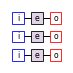

In [4]:

from grafx.draw import draw_grafx

draw_grafx(G)

In [4]:

import torch
from grafx.render import render_grafx

source=torch.cat([x,x,x],dim=0)
output, intermediates, signal_bufer = render_grafx( processors, source, parameters, render_data, parameters_grad=False, input_signal_grad=False)

In [14]:

print("output shape:", output.shape)
print("intermediates shape:", intermediates)
print("signal buffer shape:", signal_bufer.shape)

output shape: torch.Size([3, 1, 524288])
intermediates shape: []
signal buffer shape: torch.Size([9, 1, 524288])


In [5]:

parameters["reverb"]

ParameterDict(
    (delta_log_magnitude): Parameter containing: [torch.FloatTensor of size 3x1x50]
    (init_log_magnitude): Parameter containing: [torch.FloatTensor of size 3x1x50]
)

In [8]:


ipd.display(ipd.Audio(source[0].detach().numpy(), rate=sr, normalize=False))

In [6]:
log_magnitude_params=torch.zeros_like(parameters["reverb"]["init_log_magnitude"][0])

#sample log_magnitude parameters uniformly random between -40 and 10 dB
log_magnitude_params.uniform_(-2, 2)  # Uniformly sample between -5 and 5 dB
log_magnitude_params=log_magnitude_params.unsqueeze(0).repeat(number_of_sources, 1,1)


parameters["reverb"]["init_log_magnitude"]=log_magnitude_params


t60_values=torch.zeros_like(parameters["reverb"]["delta_log_magnitude"][0])
t60_mean=0.5
t60_max=1.5
t60_min=0.5
t60_values.uniform_(t60_min, t60_max)
t60_values=t60_values.unsqueeze(0).repeat(number_of_sources, 1,1)

sr= 44100
hop_length=192
delta_log_magnitude_params = 6.908/ (t60_values*(sr/hop_length))  # Convert T60 to delta log magnitude

parameters["reverb"]["delta_log_magnitude"] = delta_log_magnitude_params




#input=torch.zeros_like(x)
#input[...,0]=1.0
#source=torch.cat([input,x, x],dim=0)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)
source=torch.cat([x,x_fxnorm, y_fxnorm],dim=0).to(device)


for p in processors.values():
    p.to(device)

for k, v in parameters.items():
    parameters[k] = v.to(device)


output, intermediates, signal_bufer = render_grafx( processors, source, parameters, render_data, parameters_grad=False, input_signal_grad=False)


ipd.display(ipd.Audio(output[0].detach().cpu().numpy(), rate=sr, normalize=False))
ipd.display(ipd.Audio(output[1].detach().cpu().numpy(), rate=sr, normalize=False))
ipd.display(ipd.Audio(output[2].detach().cpu().numpy(), rate=sr, normalize=False))

Using device: cuda


In [10]:

parameters["eq"]["log_magnitude"].shape


torch.Size([3, 1, 64])

In [ ]:
sr=44100
ir_len = 22050
n_fft = 384
hop_length = 192
num_frames = 1 + (ir_len // hop_length)
arange = torch.arange(num_frames).view(1, 1, 1, -1)


log_magnitude_params=torch.zeros(1,   n_fft // 2 + 1)
#log_magnitude_params.uniform_(-10, 10)


t60_values=torch.zeros_like(log_magnitude_params)

t60_values_mean=0.5

#can we express this as T60??
t60_values.uniform_(t60_values_mean, t60_values_mean)

decays=6.908/ (t60_values*(sr/hop_length))  # Convert T60 to decay rate (in dB per second)

log_delta_magnitude=decays


log_magnitude_params = log_magnitude_params.unsqueeze(0)
log_delta_magnitude= log_delta_magnitude.unsqueeze(0)


import torch.nn.functional as F
print("Log magnitude parameters shape:", log_magnitude_params.shape, log_delta_magnitude.shape, arange.shape)

log_magnitude_params = log_magnitude_params[:, :, :, None]  # Add a new dimension for broadcasting
delta_log_magnitude = -torch.abs(log_delta_magnitude)[:, :,:,  None]
#delta_log_magnitude = log_delta_magnitude[:,:,:,None]  # Apply the decay rate over the frames

mask_log_magnitude =log_magnitude_params + delta_log_magnitude * arange

#print values on dB, careful they are on "log"
ln_to_db_factor = 20 / torch.log(torch.tensor(10.0))
print("Log magnitude parameters (dB):", mask_log_magnitude * ln_to_db_factor)


Log magnitude parameters shape: torch.Size([1, 1, 193]) torch.Size([1, 1, 193]) torch.Size([1, 1, 1, 115])
Log magnitude parameters (dB): tensor([[[[  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613],
          [  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613],
          [  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613],
          ...,
          [  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613],
          [  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613],
          [  0.0000,  -0.5225,  -1.0449,  ..., -58.5164, -59.0388, -59.5613]]]])


In [62]:
mask_log_magnitude

tensor([[[[ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572],
          [ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572],
          [ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572],
          ...,
          [ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572],
          [ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572],
          [ 0.0000, -0.0602, -0.1203,  ..., -6.7369, -6.7971, -6.8572]]]])

In [11]:

print(log_magnitude_params.shape)
print(log_delta_magnitude.shape)
print(arange.shape)

torch.Size([1, 50])
torch.Size([1, 50])
torch.Size([1, 1, 1, 32])
